# Sampled Music Detection Based on DTW

**IMPORTANT INFO!!** The algorithm didn't work very well for this two songs BUT after slowing down, it found the exact fragment that uses the sample. 

My guess: Shakira's wakawaka is faster than the original song, so after manipulating the speed it gets closer to the original. It means that our algorithm is vulnerable to tempo variations of the sample. The tempo of two songs must be pretty close for our algorithm to work. That explains to an extent why it does not work at times.

Furthermore! What we could do is to manually make the two songs be in the same tempo (beat tracking+change them to equal) and then do the rest.

Maybe we should look up some more articles about how to deal with tempo changes. (cover detection has the same problem)

found one: http://www.iro.umontreal.ca/~pift6080/H09/documents/papers/EllisP07-coversongs.pdf
Basically it extracts one chroma feature sequence per beat. So first beat tracking+chroma feature extraction (or CENS in our case?). And then do DTW on each pair of feature sequences. It seems to require a lot of computation though. For us we can 

In [1]:
import os
import sys
import numpy as np
import librosa
from numba import jit
import matplotlib.pyplot as plt
from matplotlib import patches
# from dtaidistance import dtw
from pydub import AudioSegment

import libfmp.b
import libfmp.c3
import libfmp.c7

In [2]:
def segment(sig, start=0.0, duration=10.0):
    start = int(start*Fs)
    duration = int(duration*Fs)
    return sig[start: start+duration]

In [3]:
file_1 = "WakaWaka-Shakira.wav"
file_2 = "ZaminaWakaWaka.wav"
data_dir = "songs"

In [5]:
Fs = 22050
N_feat = 4410
H_feat = 2205

fn1 = os.path.join(data_dir, file_1)
fn2 = os.path.join(data_dir, file_2)

x1, Fs = librosa.load(fn1, sr=Fs)

x1 = segment(x1, start=21.0, duration=220.0)

x2, Fs = librosa.load(fn2, sr=Fs)
# duration = librosa.get_duration(y=x1, sr=Fs)

##This song starts a little later, so i eliminated the initial silence

x2 = segment(x2, start=5.0, duration=258.0)

In [6]:
import IPython.display as ipd
ipd.Audio(data=x1, rate=Fs)

In [7]:
ipd.Audio(data=x2, rate=Fs)

## Preprocessing
DTW on the time domain:

We split song A into 1-second fragments, and choose the fragment with the least distance to song B

In [8]:
def DTW_cost_matrix(x1_audio, x2_audio, sample_rate, ell=21, d=5):
    N_feat = 4410
    H_feat = 2205
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    return C_FMP

In [9]:
C = DTW_cost_matrix(x1, x2, Fs, ell=24, d=5)

In [10]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

53.0 192.0


## DTW Based Matching: finding the optimal subsequence

- Given two feature sequences, we need to find a subsequence within the longer sequence that optimally fits the shorter one
- We take Chroma features as feature sequences

In [11]:
def DTW_matching(x1, x2, ell=21, d=5):
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    sigma = np.array([[1, 0], [0, 1], [1, 1]])
    D_librosa, P_librosa = librosa.sequence.dtw(C=C_FMP, step_sizes_sigma=sigma, subseq=True, backtrack=True)
    P_librosa = P_librosa[::-1, :]
    
    return D_librosa, P_librosa

In [12]:
def plot_DTW_path(D_librosa, P_librosa):
    # plot
    cmap = libfmp.b.compressed_gray_cmap(alpha=-10, reverse=True)
    fig, ax = plt.subplots(figsize=(15, 5))
    # title='LibROSA implementation with step size condition $\Sigma=\{(1, 0), (0, 1), (1, 1)\}$'
    libfmp.c3.plot_matrix_with_points(D_librosa, P_librosa, ax=[ax], cmap=cmap, 
                                      xlabel=f'Sequence Y ({file_2})', ylabel=f'Sequence X ({file_1})', 
                                      # title=title,
                                      marker='o', linestyle='-')
    ax.set_title("DTW Optimal Warping Path")

In [56]:
ell = 21
d = 5
duration = 20
fragment = segment(x1, t1, duration)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

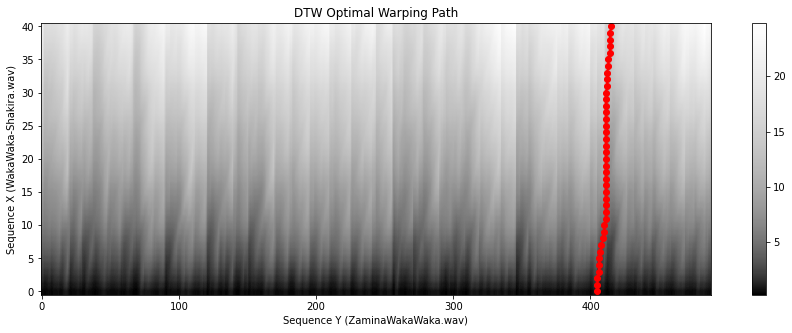

In [57]:
plot_DTW_path(D_librosa, P_librosa)

### DTW Optimal Subsequence

In [58]:
def DTW_subsequence(D_librosa, P_librosa):
    # Subsequence DTW
    N = D_librosa.shape[0]
    Delta_DTW = D_librosa[-1, :] / N # matching function
    a_ast = P_librosa[0, 1]
    b_ast = P_librosa[-1, 1]
    return Delta_DTW, a_ast, b_ast

In [59]:
def plot_DTW_subsequence(Delta_DTW, a_ast, b_ast):
    fig, ax = plt.subplots(figsize=(15, 5))
    libfmp.b.plot_signal(Delta_DTW, ax=ax, xlabel='Time (samples)', ylabel='', ylim=[0, 5],
                         title=r'Matching function $\Delta_\mathrm{DTW}$', color='k')
    ax.set_xlim([-0.5, len(Delta_DTW)-0.5])
    ax.grid()
    ax.plot(b_ast, Delta_DTW[b_ast], 'ro')
    ax.add_patch(patches.Rectangle((a_ast-0.5, 0), b_ast-a_ast+1, 7, facecolor='r', alpha=0.2))

In [60]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

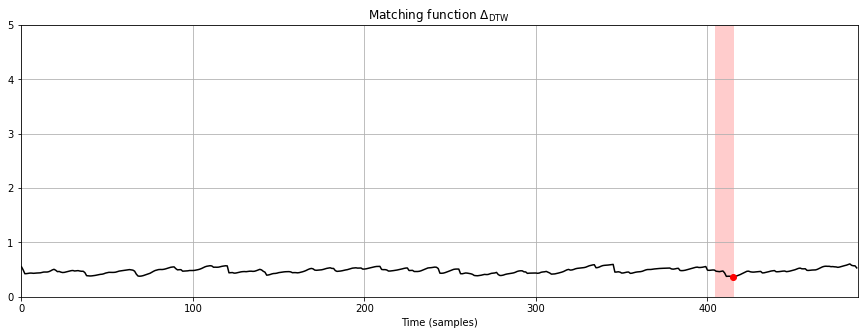

In [61]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

## Result: Sampled fragment

In [62]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

In [63]:
ipd.Audio(data=fragment, rate=Fs)

# Evaluation

In [ ]:
##This is not exactly equal but the rythm is similar tho

In [22]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

45.621844550034695


In [47]:
noice = np.random.normal(size=len(x1))
x1_ = x1 + 0.1*noice

In [48]:
C = DTW_cost_matrix(x1_, x2, Fs, ell=24, d=5)

In [49]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

53.5 19.5


In [50]:
ell = 21
d = 5
fragment = segment(x1_, t1, duration=20)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

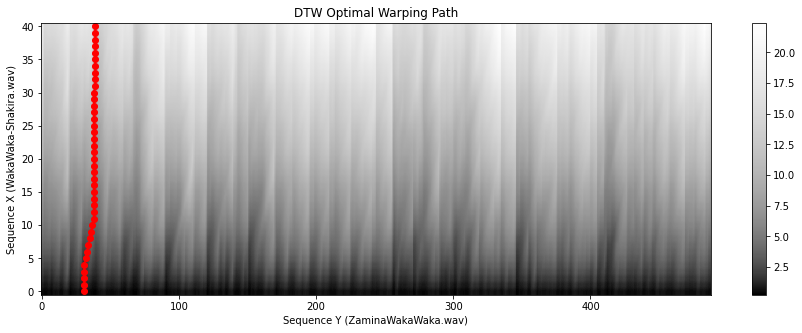

In [51]:
plot_DTW_path(D_librosa, P_librosa)

In [52]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

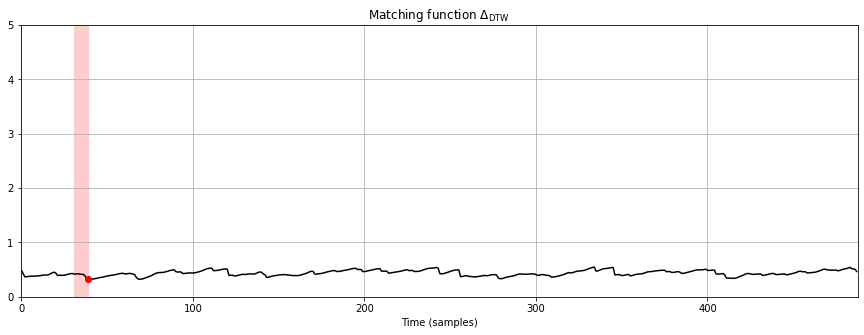

In [53]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

In [54]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

In [55]:
ipd.Audio(data=fragment, rate=Fs)

In [32]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

81.63892336507969


In [64]:
#Tempo adjustment
sound = AudioSegment.from_file(fn1)

def speed_change(sound, speed=1.0):
    # Manually override the frame_rate. This tells the computer how many
    # samples to play per second
    sound_with_altered_frame_rate = sound._spawn(sound.raw_data, overrides={
         "frame_rate": int(sound.frame_rate * speed)
      })
     # convert the sound with altered frame rate to a standard frame rate
     # so that regular playback programs will work right. They often only
     # know how to play audio at standard frame rate (like 44.1k)
    return sound_with_altered_frame_rate.set_frame_rate(sound.frame_rate)


slow_sound = speed_change(sound, 3.5)

In [65]:
slow_s_x1 = slow_sound.get_array_of_samples() 
slow_s_x1 = np.array(slow_s_x1, dtype='float32')

slow_s_x1 = segment(slow_s_x1, start=27.0, duration=273.0)

In [66]:
ipd.Audio(data=slow_s_x1, rate=Fs)

In [67]:
C = DTW_cost_matrix(slow_s_x1, x2, Fs, ell=24, d=5)

In [68]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

183.5 19.5


In [69]:
ell = 21
d = 5
fragment = segment(slow_s_x1, t1, duration=35)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

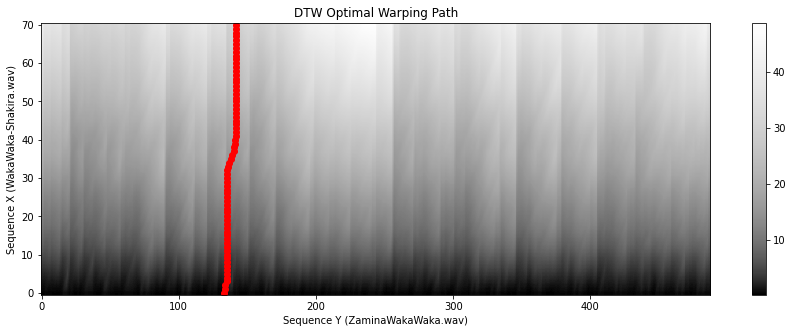

In [70]:
plot_DTW_path(D_librosa, P_librosa)

In [71]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

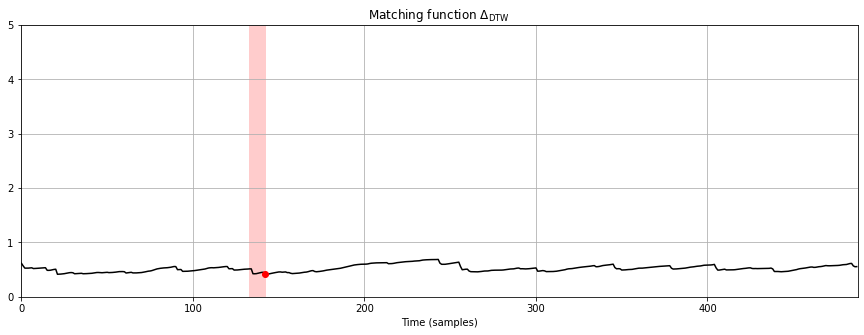

In [72]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

In [73]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

In [74]:
ipd.Audio(data=fragment, rate=Fs)

In [86]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

5056390.681044681
